In [146]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier

In [185]:

df = pd.read_csv('datasets/mixed_data_2022_1_31_15.csv')
len(df)

5923301

In [186]:
data_0_0 = pd.read_csv('/Users/jakubpazio/Imperial/Master Project/new-physics/new-physics/toy_data/flavio_tests/data/toy_data_c9_0.0_c10_0.0_2022_1_27_15.csv', index_col=0)

In [187]:
df.drop(columns=['BR_rnd','dBR_rnd','dBR','BR_interpolated'], inplace=True)

In [188]:
df[df.c10==0]

,q2,k,l,p,c9,c10
436569,4.465867,0.960767,2.601441,0.022524,-3.0,0.0
436570,2.830027,2.630458,2.385354,-2.175256,-3.0,0.0
436571,2.316175,0.610464,1.924607,1.739059,-3.0,0.0
436572,1.711917,2.902235,0.915504,2.820665,-3.0,0.0
436573,2.172262,1.752519,2.091584,1.177569,-3.0,0.0
...,...,...,...,...,...,...
5476284,3.155548,2.845723,2.308334,-1.356240,3.0,0.0
5476285,0.602107,1.404304,2.449829,2.759508,3.0,0.0
5476286,5.115664,3.043045,2.504124,1.188223,3.0,0.0
5476287,0.962191,1.530868,1.060183,-2.110397,3.0,0.0


In [189]:
# df.drop(columns=['BR_rnd'], inplace=True)
for c10 in df.c10.unique():
    

SyntaxError: unexpected EOF while parsing (<ipython-input-189-bf5d030319e6>, line 3)

In [190]:
df_minus_3 = df[(df.c9 == -3) & (df.c10 == -3)]
df_minus_2 = df[(df.c9 == -2) & (df.c10 == -2)]
df_minus_1 = df[(df.c9 == -1) & (df.c10 == -1)]
df_0 = df[(df.c9 == 0) & (df.c10 == 0)]
df_1 = df[(df.c9 == 1) & (df.c10 == 1)]
df_2 = df[(df.c9 == 2) & (df.c10 == 2)]
df_3 = df[(df.c9 == 3) & (df.c10 == 3)]

(array([0.22764222, 0.20075471, 0.18236221, 0.17899626, 0.17134274,
        0.16080412, 0.16360908, 0.16525198, 0.16348886, 0.16180589,
        0.16505163, 0.16216653, 0.1650917 , 0.17166331, 0.17274522,
        0.1705814 , 0.17643173, 0.17979768, 0.17971754, 0.17659202,
        0.18709057, 0.18372462, 0.19394267, 0.18681007, 0.19634692,
        0.19470402, 0.1993923 , 0.1996728 , 0.20508235, 0.21189439]),
 array([0.50000979, 0.68334272, 0.86667564, 1.05000857, 1.2333415 ,
        1.41667443, 1.60000735, 1.78334028, 1.96667321, 2.15000614,
        2.33333907, 2.51667199, 2.70000492, 2.88333785, 3.06667078,
        3.25000371, 3.43333663, 3.61666956, 3.80000249, 3.98333542,
        4.16666834, 4.35000127, 4.5333342 , 4.71666713, 4.90000006,
        5.08333298, 5.26666591, 5.44999884, 5.63333177, 5.8166647 ,
        5.99999762]),
 <BarContainer object of 30 artists>)

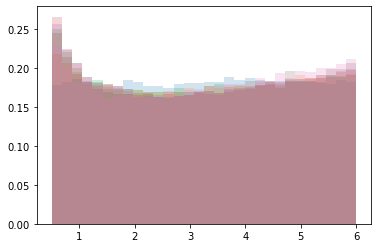

In [191]:
plt.hist(df_minus_3['q2'], alpha=0.2, bins=30, density=True)
plt.hist(df_minus_2['q2'], alpha=0.2, bins=30, density=True)
plt.hist(df_minus_1['q2'], alpha=0.2, bins=30, density=True)
plt.hist(df_0['q2'], alpha=0.2, bins=30, density=True)
plt.hist(df_1['q2'], alpha=0.2, bins=30, density=True)
plt.hist(df_2['q2'], alpha=0.2, bins=30, density=True)
plt.hist(df_3['q2'], alpha=0.2, bins=30, density=True)

In [192]:
%config InlineBackend.figure_format = 'png'

In [193]:
big_data00

,q2,k,l,p
0,9.628316,0.478162,1.973072,2.150869
1,13.925506,2.673730,2.099772,0.498232
2,4.750730,0.317639,1.702504,1.090045
3,8.883428,0.226208,1.163226,1.884230
4,5.367305,0.848416,2.470373,-0.844344
...,...,...,...,...
13375,10.465174,0.129090,1.133012,-2.955900
13376,15.473061,1.219828,0.322072,-1.792927
13377,17.694974,1.902007,0.476926,-1.129403
13378,13.123620,2.528305,1.605046,2.877888


In [199]:
big_data00 = pd.read_csv('/Users/jakubpazio/Imperial/Master Project/new-physics/new-physics/toy_data/ML_Demo/data/toy_data_c9_0_c10_0_2021_10_29_11.csv', index_col=0)
big_data00.drop(columns=['J_comp'], inplace=True)

In [200]:


log_likelihood_models = {}
for c9_t in df.c9.unique():
    for c10_t in df.c10.unique():

        X = pd.concat([df_0, df[(df.c10 == c10_t) & (df.c9 == c9_t)]]).sample(frac=1)

        Y = X[['c9','c10']]

        display(Y)

        X = X.drop(columns=['c9','c10'])
        # mlp_clf = MLPClassifier()
        mlp_clf = DecisionTreeClassifier()
        mlp_clf.fit(X.values, Y.values)

        log_likelihood = []
        for j in range(1000):
            sample = big_data00.sample(1000)
            log_probs = mlp_clf.predict_log_proba(sample)
            print(log_probs)
            log_likelihood.append(sum(log_probs))
        
        # log_likelihood_models[i][ii] = np.array(log_likelihood)
        log_likelihood_models[(c9_t, c10_t)] = np.array(log_likelihood)

,c9,c10
2530947,0.0,0.0
2507834,0.0,0.0
171513,-3.0,-3.0
93372,-3.0,-3.0
2517604,0.0,0.0
...,...,...
2491636,0.0,0.0
47220,-3.0,-3.0
2431,-3.0,-3.0
16588,-3.0,-3.0


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

,c9,c10
2477753,0.0,0.0
276757,-3.0,-2.0
205433,-3.0,-2.0
265299,-3.0,-2.0
2528026,0.0,0.0
...,...,...
194378,-3.0,-2.0
2494679,0.0,0.0
2479886,0.0,0.0
221033,-3.0,-2.0


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

,c9,c10
2444910,0.0,0.0
2529512,0.0,0.0
426514,-3.0,-1.0
2501146,0.0,0.0
2478494,0.0,0.0
...,...,...
2488659,0.0,0.0
2519513,0.0,0.0
2506331,0.0,0.0
2522021,0.0,0.0


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

,c9,c10
2457900,0.0,0.0
2504649,0.0,0.0
2501710,0.0,0.0
451048,-3.0,0.0
2528121,0.0,0.0
...,...,...
454031,-3.0,0.0
2473932,0.0,0.0
2484127,0.0,0.0
479616,-3.0,0.0


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])


[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
       [0.],
 

,c9,c10
528522,-3.0,1.0
2448780,0.0,0.0
2457900,0.0,0.0
558149,-3.0,1.0
523810,-3.0,1.0
...,...,...
2496608,0.0,0.0
2462577,0.0,0.0
2517790,0.0,0.0
545491,-3.0,1.0


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

,c9,c10
2531132,0.0,0.0
2481192,0.0,0.0
2500031,0.0,0.0
2514910,0.0,0.0
2453031,0.0,0.0
...,...,...
2495822,0.0,0.0
2528678,0.0,0.0
2492819,0.0,0.0
2523515,0.0,0.0


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

,c9,c10
2510428,0.0,0.0
2459288,0.0,0.0
2463158,0.0,0.0
2450679,0.0,0.0
615417,-3.0,3.0
...,...,...
612241,-3.0,3.0
2485332,0.0,0.0
2525831,0.0,0.0
2526258,0.0,0.0


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

,c9,c10
2468565,0.0,0.0
2509275,0.0,0.0
697111,-2.0,-3.0
676619,-2.0,-3.0
735885,-2.0,-3.0
...,...,...
754205,-2.0,-3.0
755112,-2.0,-3.0
2499109,0.0,0.0
2463896,0.0,0.0


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

,c9,c10
816303,-2.0,-2.0
897883,-2.0,-2.0
869643,-2.0,-2.0
2488287,0.0,0.0
944465,-2.0,-2.0
...,...,...
2477048,0.0,0.0
940332,-2.0,-2.0
944891,-2.0,-2.0
2453518,0.0,0.0


/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [  0., -inf],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

[array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[  0., -inf],
       [  0., -inf],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [-inf,   0.],
       [  0., -inf],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [-inf,   0.],
       [  0., -inf]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[  0., -i

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]


[array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]]), array([[-inf,   0.],
       [  0., -inf],
       [-inf,   0.],
       ...,
       [  0., -inf],
       [  0., -inf],
       [  0., -inf]])]
[array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]]), array([[-inf,   0.],
       [-inf,   0.],
       [  0., -inf],
       ...,
       [  0., -inf],
       [  0., -inf],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]])]
[array([[  0., -inf],
       [-inf,   0.],
       [-inf,   0.],
       ...,
       [-inf,   0.],
       [-inf,   0.],
       [-inf,   0.]]), array([[  0., -

/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k] = np.log(proba[k])
/Users/jakubpazio/opt/anaconda3/lib/python3.8/site-packages/sklearn/tree/_classes.py:969: RuntimeWarning: divide by zero encountered in log
  proba[k]

,c9,c10
2491854,0.0,0.0
1013806,-2.0,-1.0
1007557,-2.0,-1.0
1020069,-2.0,-1.0
2537493,0.0,0.0
...,...,...
2493256,0.0,0.0
997878,-2.0,-1.0
1033700,-2.0,-1.0
2489776,0.0,0.0


KeyboardInterrupt: 

In [197]:
Y.values

array([[0., 0.],
       [0., 0.],
       [3., 3.],
       ...,
       [3., 3.],
       [0., 0.],
       [3., 3.]])

In [198]:
log_likelihood_models

{(-3.0,
  -3.0): array([[[  0., -inf],
         [  0., -inf],
         [  0., -inf],
         ...,
         [  0., -inf],
         [-inf,   0.],
         [  0., -inf]],
 
        [[-inf,   0.],
         [-inf,   0.],
         [  0., -inf],
         ...,
         [-inf,   0.],
         [  0., -inf],
         [  0., -inf]],
 
        [[-inf,   0.],
         [-inf,   0.],
         [-inf,   0.],
         ...,
         [  0., -inf],
         [  0., -inf],
         [  0., -inf]],
 
        ...,
 
        [[  0., -inf],
         [-inf,   0.],
         [  0., -inf],
         ...,
         [  0., -inf],
         [  0., -inf],
         [  0., -inf]],
 
        [[  0., -inf],
         [-inf,   0.],
         [  0., -inf],
         ...,
         [  0., -inf],
         [-inf,   0.],
         [  0., -inf]],
 
        [[  0., -inf],
         [-inf,   0.],
         [  0., -inf],
         ...,
         [  0., -inf],
         [  0., -inf],
         [-inf,   0.]]]),
 (-3.0,
  -2.0): array([[[-inf,   0.],


In [164]:

test_clf = DecisionTreeClassifier()
xx = np.random.random((100,10))
yy = np.random.randint(0, 4, (100,2))
test_clf.fit(xx, yy)

DecisionTreeClassifier()

In [ ]:
test_clf.predict_proba(np.random.random((100, 10)))

array([[0, 0],
       [1, 2],
       [0, 0],
       [2, 3],
       [0, 0],
       [2, 0],
       [1, 1],
       [1, 2],
       [3, 3],
       [0, 0],
       [3, 2],
       [2, 2],
       [3, 1],
       [1, 0],
       [2, 3],
       [1, 1],
       [3, 0],
       [2, 0],
       [0, 0],
       [1, 1],
       [3, 0],
       [1, 1],
       [1, 1],
       [1, 3],
       [0, 3],
       [1, 0],
       [1, 0],
       [1, 1],
       [1, 0],
       [1, 1],
       [0, 1],
       [1, 1],
       [2, 1],
       [0, 0],
       [2, 1],
       [1, 2],
       [3, 0],
       [1, 3],
       [3, 0],
       [1, 0],
       [1, 3],
       [1, 1],
       [1, 1],
       [1, 3],
       [3, 3],
       [1, 0],
       [3, 1],
       [1, 1],
       [1, 2],
       [3, 0],
       [1, 0],
       [0, 1],
       [3, 0],
       [1, 3],
       [3, 1],
       [2, 3],
       [3, 1],
       [2, 0],
       [0, 0],
       [1, 2],
       [1, 1],
       [3, 0],
       [0, 3],
       [3, 1],
       [3, 2],
       [2, 3],
       [0,

In [162]:
log_likelihood_models

{}

In [159]:
for k, arr in log_likelihood_models.items():
    mean_0 = arr[:, 0].mean()
    mean_1 = arr[:, 1].mean()
    std_0 = arr[:, 0].std()
    std_1 = arr[:, 1].std()

    plt.errorbar(k, mean_0, marker='.', yerr=std_0,c='tab:blue', capsize=4)
    plt.errorbar(k, mean_1, marker='.', yerr=std_1,c='tab:orange', capsize=4)
# plt.show()

TypeError: list indices must be integers or slices, not tuple